In [1]:
from utils import get_fft_dict, get_selected_data, select_index

In [2]:
from sklearn.model_selection import train_test_split
train_names = ['1st_Normal', '1st_Bearing', '1st_Unbalance', '1st_Looseness', '1st_high',
               '2nd_Bearing', '2nd_Looseness', '2nd_Unbalance', '3rd_Normal', '3rd_Unbalance']
train_data = get_fft_dict(train_names,is_datelabel=True)
selected_index = select_index(train_data,0.5)
selected_data,label_list = get_selected_data(train_data,selected_index)
X = selected_data
y = label_list
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

1st_Normal


1485it [00:07, 202.58it/s]


1st_Bearing


1800it [00:08, 203.29it/s]


1st_Unbalance


1117it [00:05, 205.37it/s]


1st_Looseness


609it [00:02, 206.49it/s]


1st_high


415it [00:02, 205.36it/s]


2nd_Bearing


3890it [00:19, 203.04it/s]


2nd_Looseness


3069it [00:15, 203.16it/s]


2nd_Unbalance


2853it [00:14, 203.00it/s]


3rd_Normal


5017it [00:24, 204.02it/s]


3rd_Unbalance


2239it [00:10, 204.41it/s]


In [3]:
train_data.keys()

dict_keys(['1st_Normal', '1st_Bearing', '1st_Unbalance', '1st_Looseness', '1st_high', '2nd_Bearing', '2nd_Looseness', '2nd_Unbalance', '3rd_Normal', '3rd_Unbalance'])

In [15]:
import numpy as np

get_stat = lambda fft_array : np.vstack([fft_array.std(axis=0),
                                         fft_array.mean(axis=0)])

In [28]:
stat = get_stat(train_data[key])

In [42]:
10544/2/2/2/2

659.0

In [47]:
np.sqrt(659)

25.67099530598687

In [58]:
N//K

16

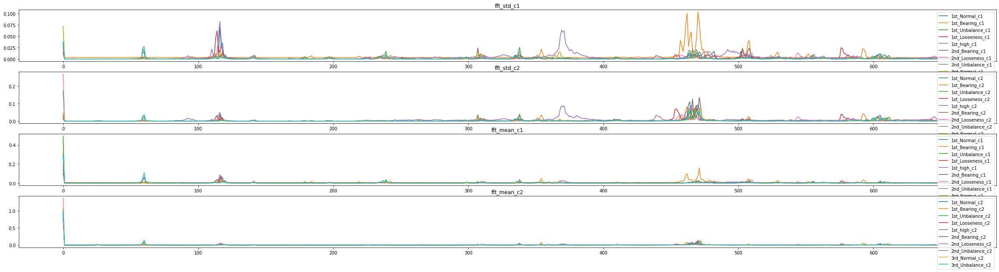

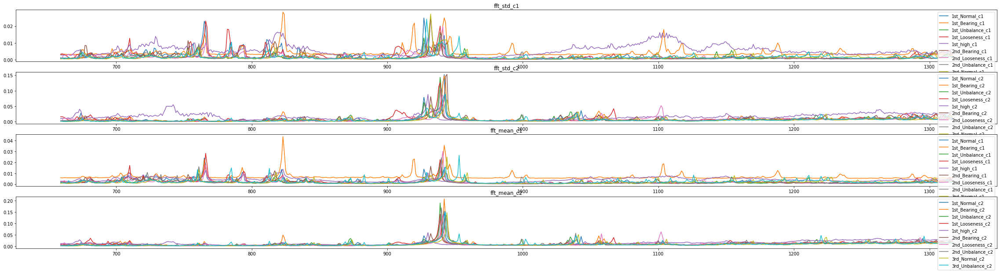

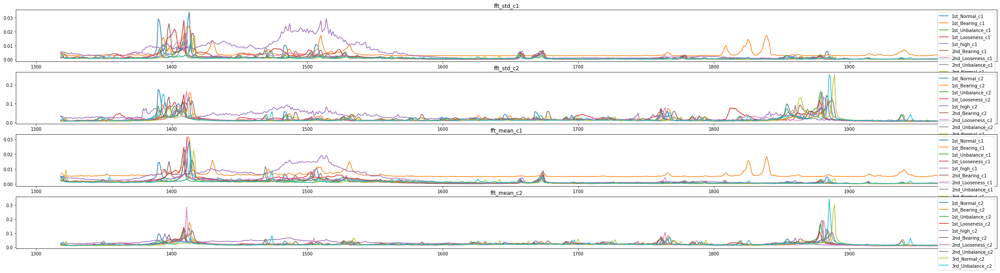

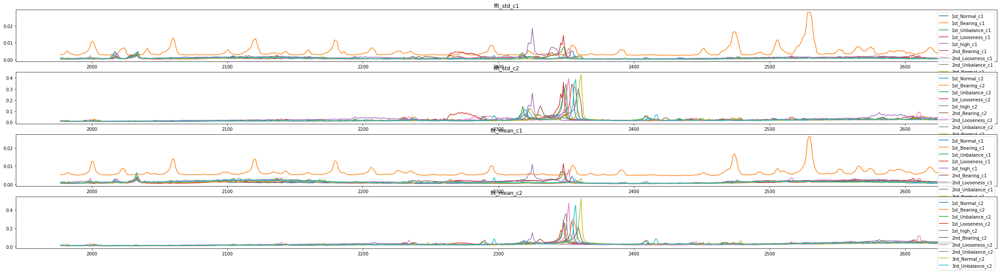

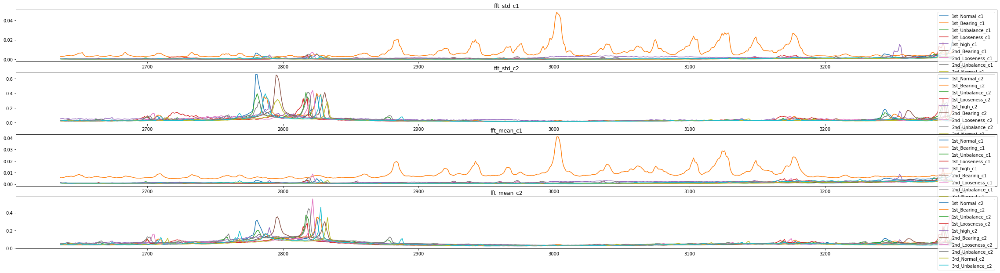

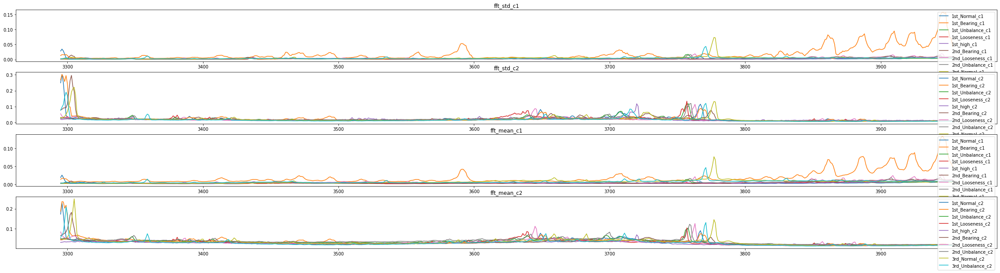

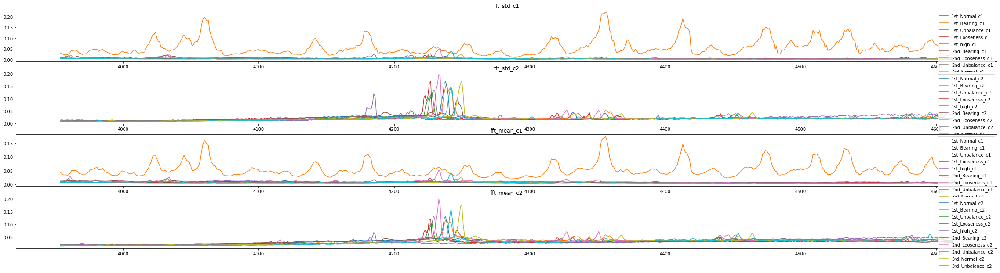

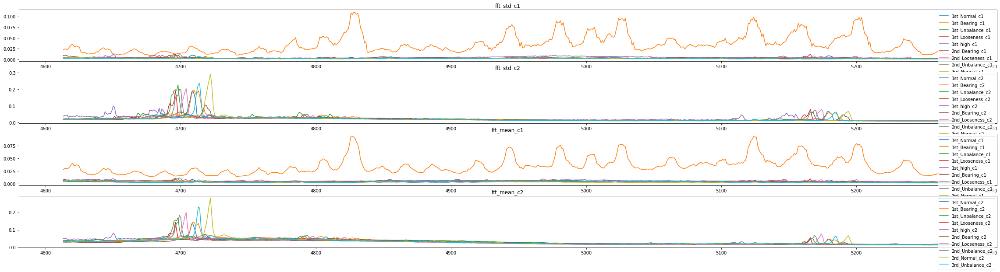

In [60]:
import matplotlib.pyplot as plt 
N = 10544
K=659
for r in range(N//K//2):
    fig,ax = plt.subplots(4,1,figsize=[40,10])
    for key in train_data:
        stat = get_stat(train_data[key])
        rangeK = range(r*K,(r+1)*K)
        ax[0].plot(rangeK,stat[0][:N//2][rangeK],label=key+'_c1')
        ax[1].plot(rangeK,stat[0][N//2:][rangeK],label=key+'_c2')
        ax[2].plot(rangeK,stat[1][:N//2][rangeK],label=key+'_c1')
        ax[3].plot(rangeK,stat[1][N//2:][rangeK],label=key+'_c2')
        for i in range(4):
            ax[i].legend()
        ax[0].set_title('fft_std_c1')
        ax[1].set_title('fft_std_c2')
        ax[2].set_title('fft_mean_c1')
        ax[3].set_title('fft_mean_c2')
    plt.show()

In [4]:
# day1_data = get_fft_dict(['1st_Normal', '1st_Bearing', '1st_Unbalance', '1st_Looseness', '1st_high'])
# day23_data = get_fft_dict(['2nd_Bearing', '2nd_Looseness', '2nd_Unbalance', '3rd_Normal', '3rd_Unbalance'])
# selected_index = select_index(day1_data,0.0)
# selected_data,label_list = get_selected_data(day1_data,selected_index)
# selected_data_23,label_list_23 = get_selected_data(day23_data,selected_index)
# x_train = selected_data
# y_train = label_list
# x_test = selected_data_23
# y_test = label_list_23

Normal


1485it [00:07, 197.79it/s]


Bearing


1800it [00:08, 201.35it/s]


Unbalance


1117it [00:05, 204.87it/s]


Looseness


609it [00:02, 203.74it/s]


high


415it [00:02, 203.44it/s]


Bearing


3890it [00:18, 206.14it/s]


Looseness


3069it [00:15, 201.96it/s]


Unbalance


2853it [00:14, 202.05it/s]


Normal


5017it [00:24, 202.83it/s]


Unbalance


2239it [00:11, 203.23it/s]


In [7]:
# random_state는 시드값을 고정해줌
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_estimators=100, random_state=0)
model.fit(x_train, y_train)
model_pred = model.predict(x_test)

Accuracy: 0.6042887274431685
F1-Score: 0.6043
              precision    recall  f1-score   support

     Bearing       0.00      0.00      0.00      3890
   Looseness       0.81      0.14      0.24      3069
      Normal       0.45      0.95      0.61      5017
   Unbalance       1.00      1.00      1.00      5092
        high       0.00      0.00      0.00         0

    accuracy                           0.60     17068
   macro avg       0.45      0.42      0.37     17068
weighted avg       0.58      0.60      0.52     17068



<Axes: >

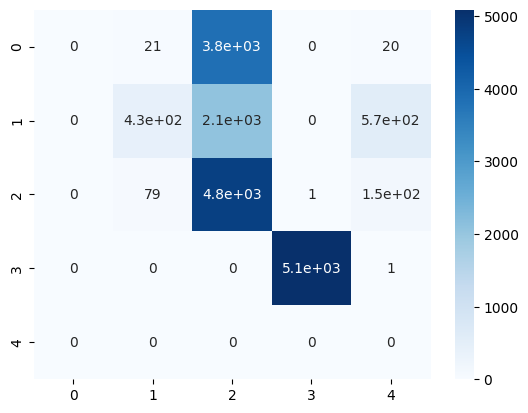

In [8]:
from sklearn.metrics import f1_score, classification_report, confusion_matrix
accuracy = model.score(x_test, y_test)
print("Accuracy:", accuracy)
# f1-score에서 average가 binary로 디폴트 설정 되어 있는데 이것은 이진분류에 적합하여 micro로 바꿔 다중 클래스 분류를 해줌
f1 = f1_score(y_test, model_pred, average='micro')
print("F1-Score: {:.4f}".format(f1))
print(classification_report(y_test, model_pred))
cm = pd.DataFrame(confusion_matrix(y_test, model_pred))
sns.heatmap(cm, annot=True, cmap='Blues')

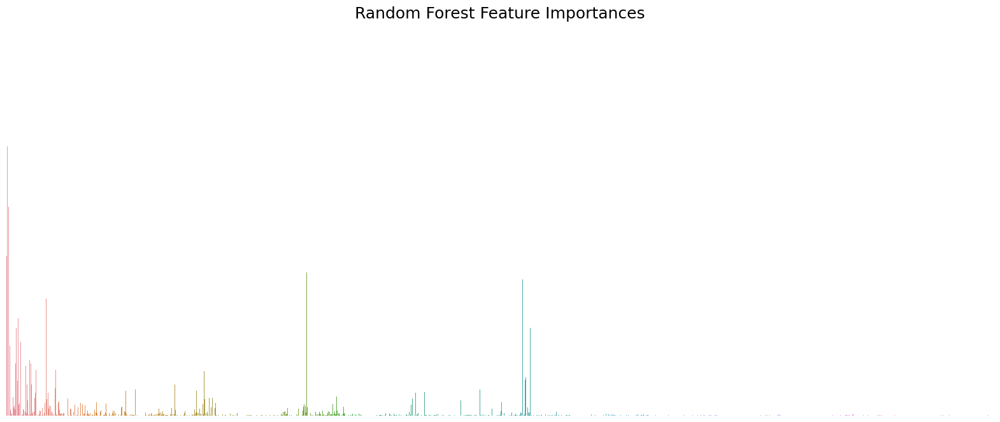

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

# Feature importances 평가

# 어레이 형태 다시 데이터 프레임으로 전환
x_train_df = pd.DataFrame(x_train)

importances = model.feature_importances_
importance_df = pd.DataFrame({'Feature': x_train_df.columns, 'Importance': importances})
importance_df = importance_df.sort_values('Importance', ascending=False)

# 특성 중요도 시각화 -> Feature들이 왜 그런진 모르겠지만 오름차순 정렬이 안됨
plt.figure(figsize=(20, 8))
sns.barplot(x='Feature', y='Importance', data = importance_df)
plt.title('Random Forest Feature Importances', fontsize=18)
plt.axis('off')
plt.show()

In [56]:
# 이동 평균을 구합니다. window는 이동 평균 구간의 크기를 나타냅니다.
window_size = 10
N1_df = pd.DataFrame(get_fft_dict(['1st_Normal'])['Normal'])
ma_N1_df = np.apply_along_axis(lambda m: np.convolve(m, np.ones(window_size) / window_size, mode='valid'), axis=1, arr=N1_df)

# # 그래프 출력
# fig, ax = plt.subplots(figsize=(50, 12))

# # 원본 데이터를 그립니다.
# for i in range(N1_df.shape[0]):
#     ax.plot(N1_df[i], alpha=0.2, color='blue')

# # 이동 평균 데이터를 그립니다.
# ax.plot(ma_N1_df, color='red')

# # 그래프 제목과 라벨 추가
# ax.set_title('Moving Average')
# ax.set_xlabel('Time')
# ax.set_ylabel('Value')

# # 범례 추가
# ax.legend(['Original', 'Moving Average'])

# # 그래프 출력
# plt.show()

Normal


1485it [00:07, 209.09it/s]


In [40]:
N1_df

,0,1,2,3,4,5,6,7,8,9,...,10534,10535,10536,10537,10538,10539,10540,10541,10542,10543
0,0.109580,0.000249,0.000291,0.000265,0.000216,0.000256,0.000253,0.000447,0.000370,0.000255,...,0.003438,0.015835,0.003438,0.005988,0.011777,0.001706,0.002573,0.013590,0.013434,0.005587
1,0.111262,0.000207,0.000088,0.000184,0.000240,0.000195,0.000157,0.000448,0.000367,0.000136,...,0.000244,0.002831,0.008168,0.001114,0.005012,0.008398,0.010197,0.004815,0.007441,0.011475
2,0.115813,0.002437,0.000108,0.001045,0.000333,0.001049,0.000424,0.000898,0.000568,0.000128,...,0.014771,0.008055,0.002543,0.008843,0.011131,0.004863,0.007540,0.003440,0.004942,0.011454
3,0.114525,0.001281,0.001020,0.000829,0.000737,0.000276,0.000483,0.000871,0.000266,0.000071,...,0.013233,0.005167,0.004890,0.002110,0.009919,0.006642,0.004402,0.009212,0.003732,0.009738
4,0.114845,0.000531,0.000057,0.000296,0.000387,0.000164,0.000332,0.000362,0.000470,0.000209,...,0.005280,0.009710,0.002472,0.005777,0.008353,0.005610,0.007511,0.002671,0.002395,0.011214
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1480,0.108158,0.001901,0.001168,0.000570,0.001276,0.000778,0.000712,0.000239,0.000471,0.000828,...,0.003604,0.018635,0.008154,0.014288,0.008161,0.026213,0.016096,0.021337,0.029313,0.010975
1481,0.107019,0.001813,0.000410,0.000643,0.000421,0.000229,0.000201,0.000911,0.000109,0.000645,...,0.012759,0.019149,0.014380,0.019113,0.010387,0.007701,0.017130,0.015931,0.024622,0.030349
1482,0.104030,0.000388,0.000252,0.000195,0.000347,0.000580,0.000533,0.001391,0.000437,0.000416,...,0.005549,0.019943,0.012451,0.020417,0.017627,0.039242,0.014583,0.006483,0.012924,0.009034
1483,0.104334,0.000155,0.000243,0.000047,0.000109,0.000141,0.000221,0.000995,0.000500,0.000404,...,0.022950,0.004532,0.013070,0.025441,0.018163,0.007316,0.011272,0.053329,0.028801,0.014067


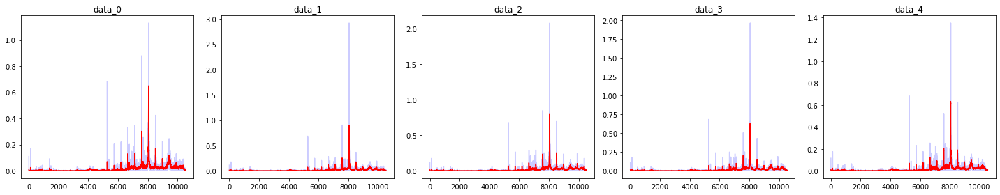

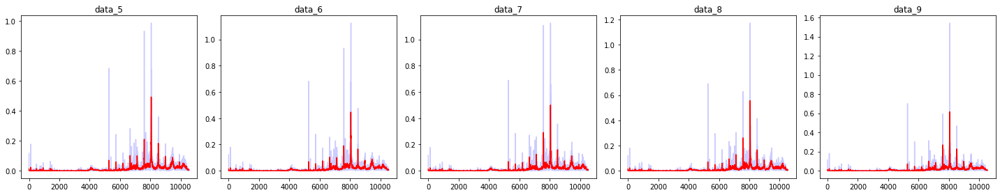

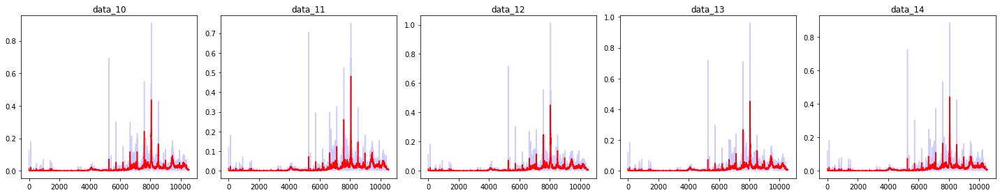

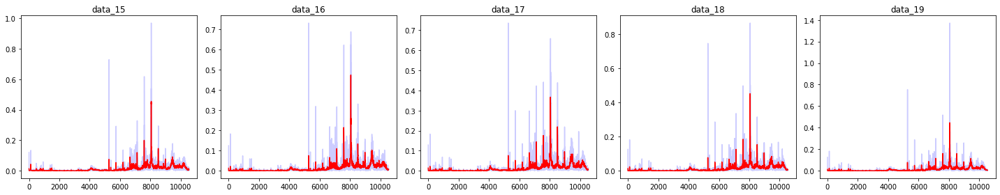

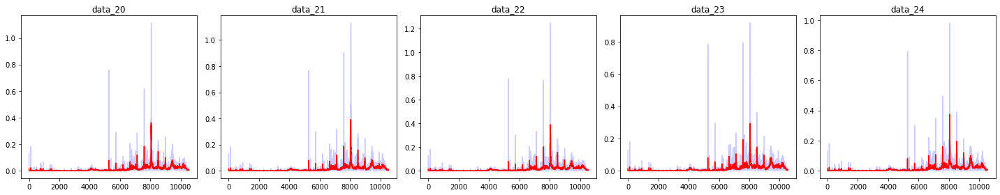

...

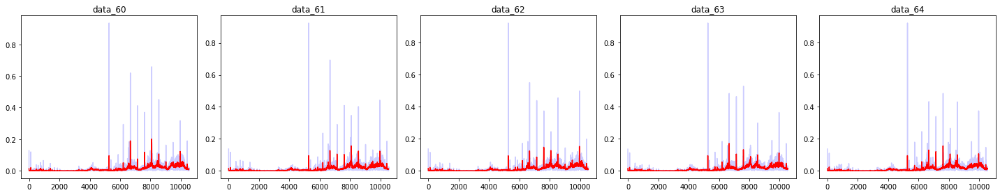

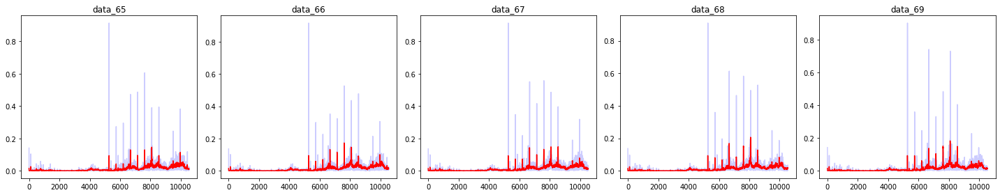

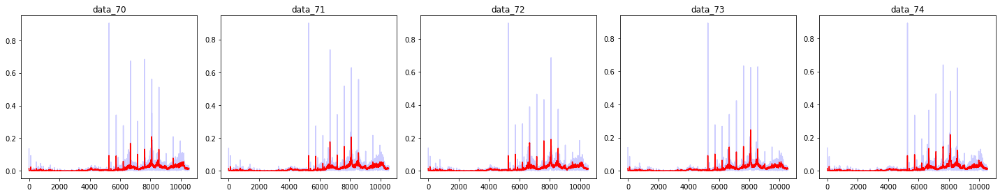

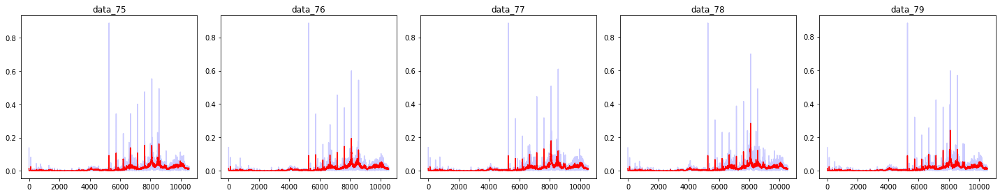

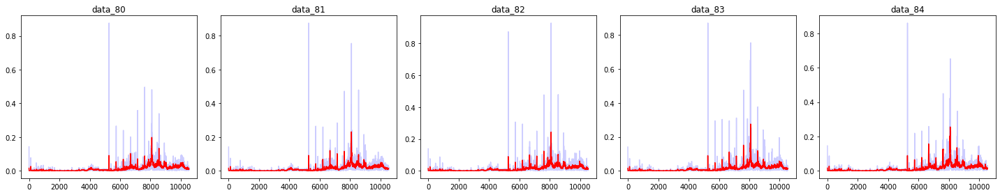

KeyboardInterrupt: 

In [62]:
# 원본 데이터를 그립니다.
for i in range(N1_df.shape[1]):
    if i%5==0:
        fig, ax = plt.subplots(1,5,figsize=(20, 4))
        ax = np.reshape(ax,-1)
    ax[i%5].plot(N1_df.iloc[i,:], alpha=0.2, color='blue')
    ax[i%5].plot(ma_N1_df[i,:], color='red')
    ax[i%5].set_title(f'data_{i}')
    if i%5==4:
        plt.tight_layout()
        plt.show()

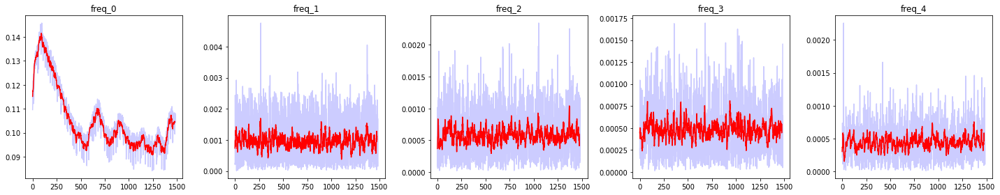

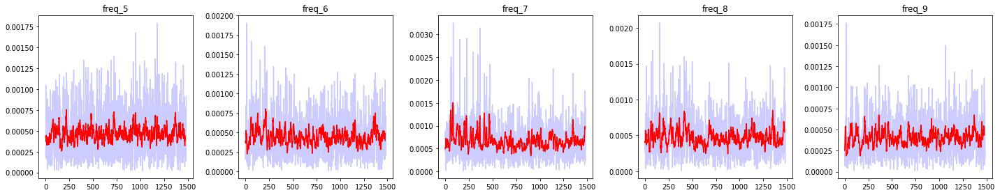

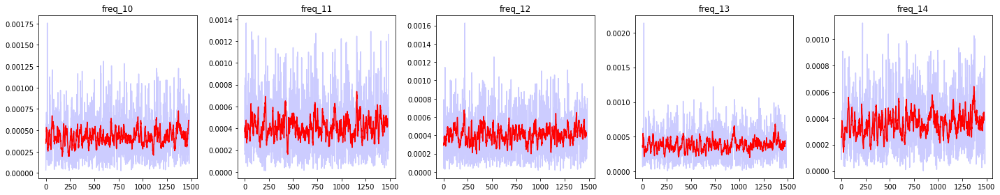

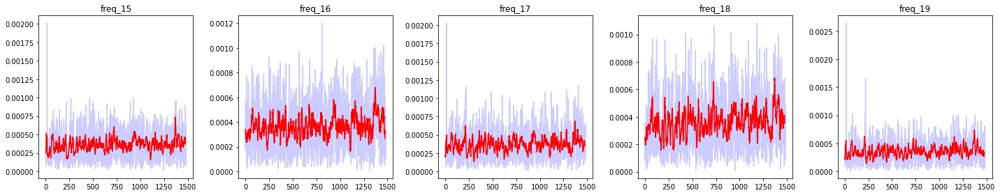

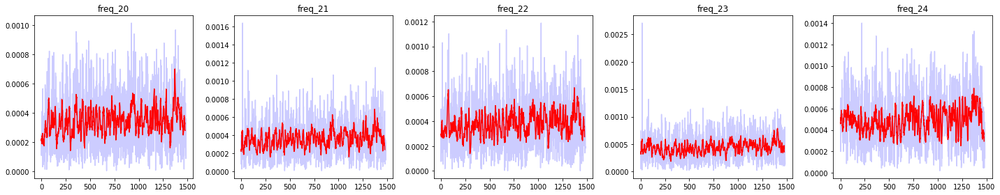

...

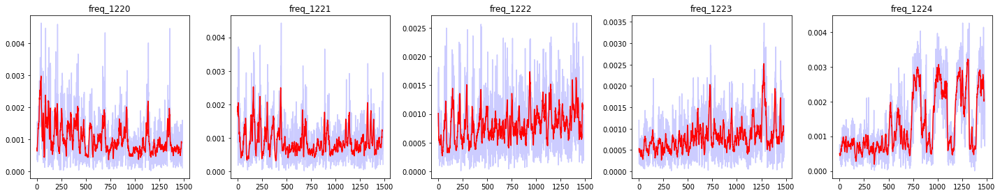

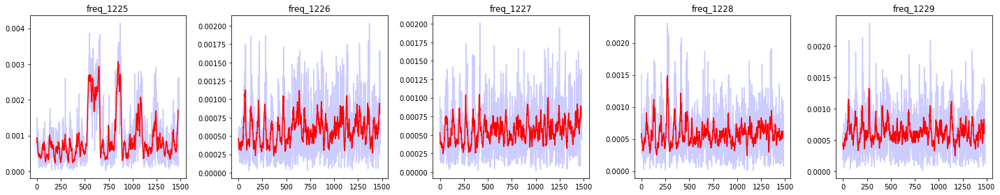

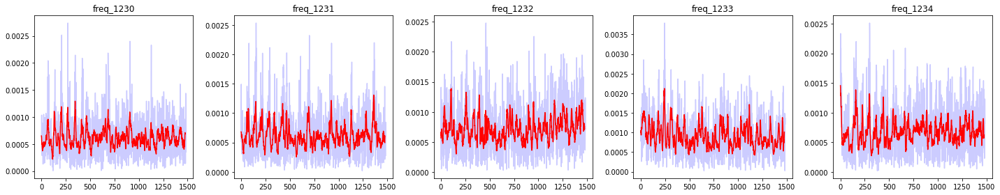

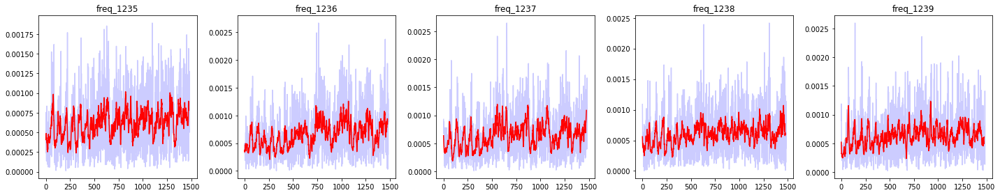

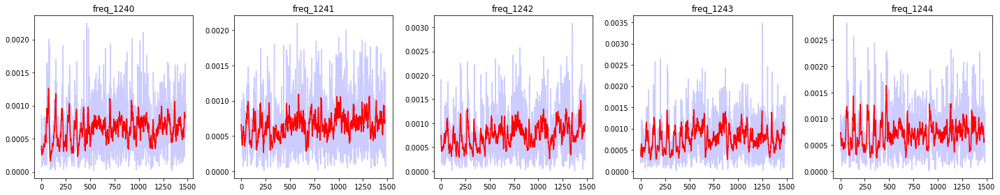

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7fd0b5dea4c0> (for post_execute):



KeyboardInterrupt



In [54]:
# 원본 데이터를 그립니다.
for i in range(N1_df.shape[0]):
    if i%5==0:
        fig, ax = plt.subplots(1,5,figsize=(20, 4))
        ax = np.reshape(ax,-1)
    ax[i%5].plot(N1_df[i], alpha=0.2, color='blue')
    ax[i%5].plot(ma_N1_df[:,i], color='red')
    ax[i%5].set_title(f'freq_{i}')
    if i%5==4:
        plt.tight_layout()
        plt.show()

Normal


1485it [00:07, 204.61it/s]


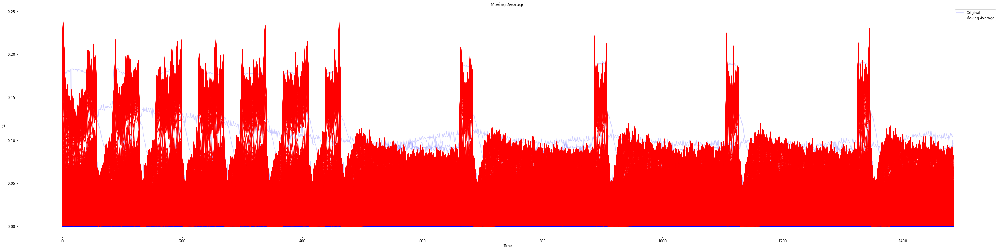

In [22]:
# 이동 평균을 구합니다. window는 이동 평균 구간의 크기를 나타냅니다.
window_size = 100
N1_df = pd.DataFrame(get_fft_dict(['1st_Normal'])['Normal'])
ma_N1_df = np.apply_along_axis(lambda m: np.convolve(m, np.ones(window_size) / window_size, mode='valid'), axis=1, arr=N1_df)

# # 그래프 출력
# fig, ax = plt.subplots(figsize=(50, 12))

# # 원본 데이터를 그립니다.
# for i in range(N1_df.shape[0]):
#     ax.plot(N1_df[i], alpha=0.2, color='blue')

# # 이동 평균 데이터를 그립니다.
# ax.plot(ma_N1_df, color='red')

# # 그래프 제목과 라벨 추가
# ax.set_title('Moving Average')
# ax.set_xlabel('Time')
# ax.set_ylabel('Value')

# # 범례 추가
# ax.legend(['Original', 'Moving Average'])

# # 그래프 출력
# plt.show()

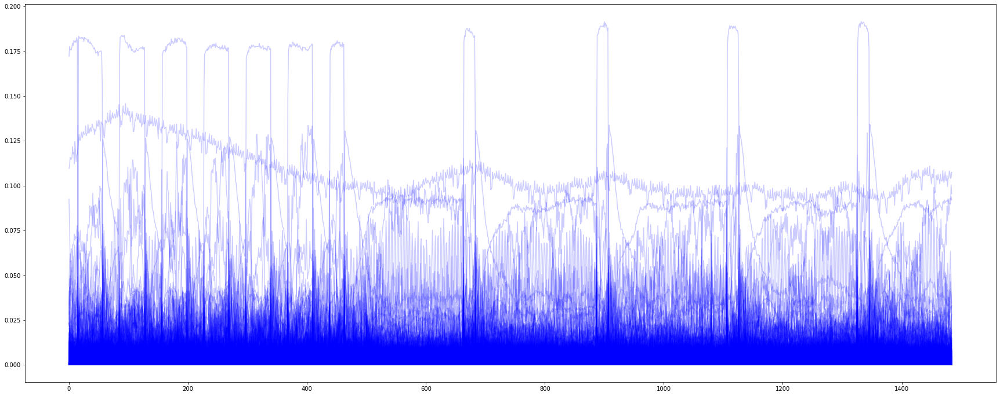

In [14]:
# 그래프 출력
fig, ax = plt.subplots(figsize=(30, 12))

# 원본 데이터를 그립니다.
for i in range(N1_df.shape[0]):
    ax.plot(N1_df[i], alpha=0.2, color='blue')
    
plt.show()

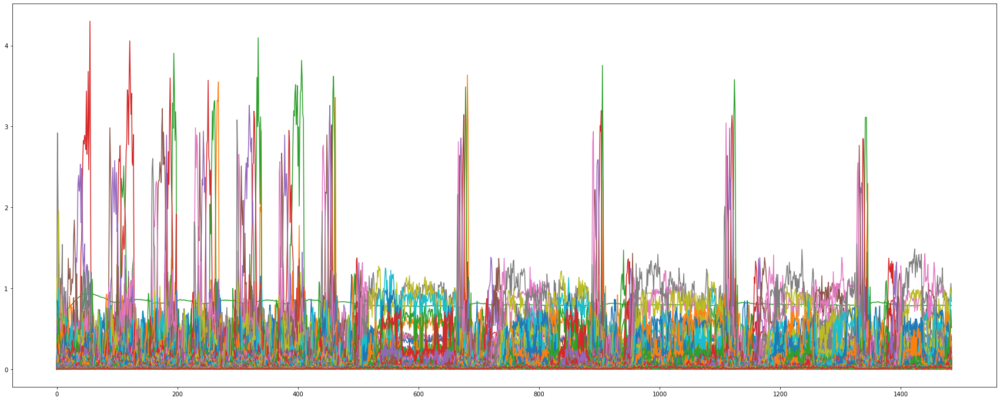

In [21]:
plt.figure(figsize=(30,12))
plt.plot(N1_df)
plt.show()